In [45]:
import os
import cv2
import torch
import numpy as np
from PIL import Image
import tensorflow as tf
from skimage import io
from scipy import ndimage
from scipy.ndimage import label, distance_transform_edt, generic_filter
from skimage.util import view_as_windows
import matplotlib.pyplot as plt
from torchvision import transforms

from sklearn.model_selection import train_test_split

from tensorflow.keras.models import Model
from tensorflow.keras.metrics import Metric
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Dropout,
                                     Conv2DTranspose, concatenate)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator


In [46]:
class IoUMetric(Metric):
    def __init__(self, name='iou_score', **kwargs):
        super(IoUMetric, self).__init__(name=name, **kwargs)
        self.iou = self.add_weight(name='iou', initializer='zeros')
        self.total_iou = self.add_weight(name='total_iou', initializer='zeros')
        self.count = self.add_weight(name='count', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_pred = tf.math.round(y_pred)  # Threshold predictions to binary (0 or 1) values
        intersection = tf.reduce_sum(y_true * y_pred)
        union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) - intersection
        iou = intersection / (union + tf.keras.backend.epsilon())
        self.total_iou.assign_add(iou)
        self.count.assign_add(1)
        
    def result(self):
        return self.total_iou / self.count

    def reset_states(self):
        self.iou.assign(0)
        self.total_iou.assign(0)
        self.count.assign(0)


In [47]:
model = tf.keras.models.load_model('/Users/bhoumik/Documents/Projects/Satellite CV Project/model-unet1.keras',custom_objects={'IoUMetric':IoUMetric()})

In [48]:
image_path = '/Users/bhoumik/Documents/Projects/Satellite CV Project/Dataset/NAIP Dataset/Evaluation/paradise_rgb.png'  

test_image = cv2.imread(image_path)
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)



In [49]:
l,w,d=test_image.shape

In [50]:
test_image=test_image[:(l//256)*256,:(w//256)*256,:]

In [51]:
test_image.shape

(2816, 9472, 3)

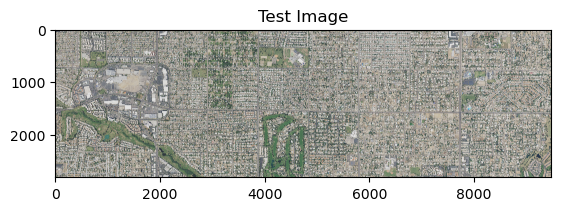

In [52]:
plt.imshow(test_image)
plt.title('Test Image')
plt.axis('on') 
plt.show()

In [53]:
test_image=test_image/255

In [54]:
patch_size = (256, 256, 3)
stride = (256, 256, 3)
patches = view_as_windows(test_image, window_shape=patch_size, step=stride)
patches = patches.reshape(-1, *patch_size)
patches = np.array(patches)
print("Shape of the patches array:", patches.shape)
patches = patches.astype(np.float32)

Shape of the patches array: (407, 256, 256, 3)


In [55]:
prediction=model.predict(patches)
prediction1 = (prediction > 0.5).astype(np.uint8)

13/13 ━━━━━━━━━━━━━━━━━━━━ 8s 536ms/step


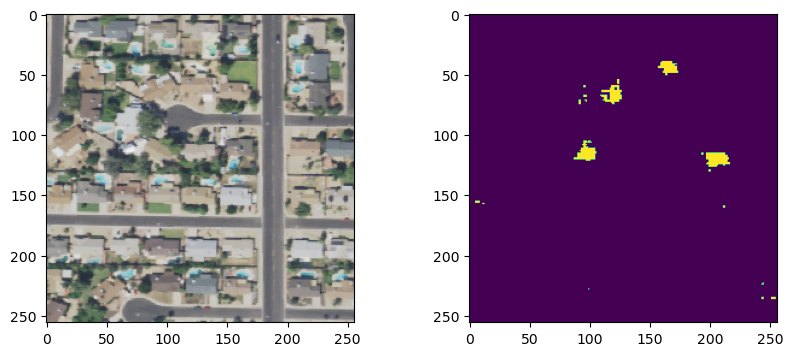

In [56]:
i=5
plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.imshow(patches[i])

plt.subplot(1,2,2)
plt.imshow(prediction1[i])

In [57]:
def stitch_patches(patches, original_shape):
    num_patches_y = original_shape[0] // 256
    num_patches_x = original_shape[1] // 256

    reshaped_patches = patches.reshape(num_patches_y, num_patches_x, 256, 256, patches.shape[3])

    stitched_image = np.zeros(original_shape, dtype=patches.dtype)

    for i in range(num_patches_y):
        for j in range(num_patches_x):
            stitched_image[i*256:(i+1)*256, j*256:(j+1)*256, :] = reshaped_patches[i, j]

    return stitched_image

original_image_shape = ((l//256)*256, (w//256)*256, 3) 
original_mask_shape = ((l//256)*256, (w//256)*256, 1) 

stitched_image = stitch_patches(patches, original_image_shape)
stitched_masks = stitch_patches(prediction1, original_mask_shape)


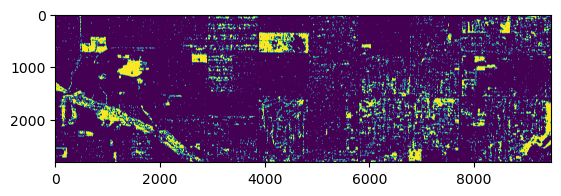

In [58]:
plt.imshow(stitched_masks)

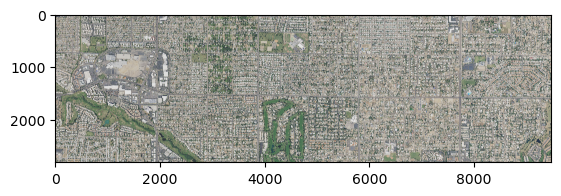

In [59]:
plt.imshow(stitched_image)

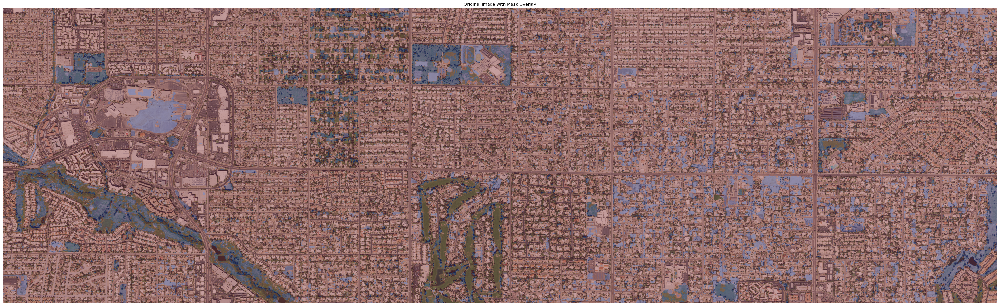

In [60]:
original_image=stitched_image*255
original_image=original_image.astype('uint8')
mask_colored = cv2.applyColorMap(cv2.convertScaleAbs(stitched_masks, alpha=255/stitched_masks.max()), cv2.COLORMAP_JET)
def blend_images(image, mask_colored, opacity=0.3):
    blended = cv2.addWeighted(image, 1-opacity, mask_colored, opacity, 0)
    return blended

opacity = 0.3
blended_image = blend_images(original_image, mask_colored, opacity=opacity)

plt.figure(figsize=(50,50))
plt.imshow(blended_image)
plt.title('Original Image with Mask Overlay')
plt.axis('off')
plt.show()


In [61]:
vacant_np=stitched_masks

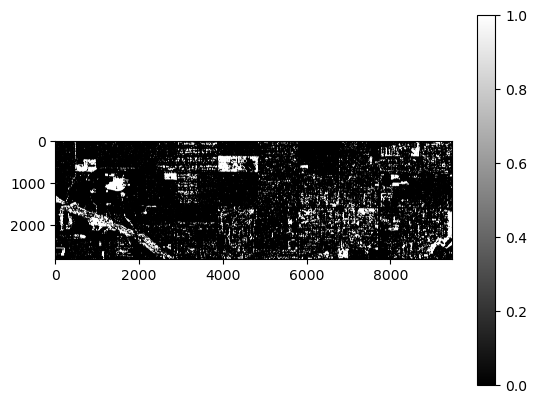

(2816, 9472, 1)


array([0, 1], dtype=uint8)

In [62]:
plt.imshow(vacant_np, cmap='gray') 
plt.colorbar()  
plt.show()
print(vacant_np.shape)
np.unique(vacant_np)

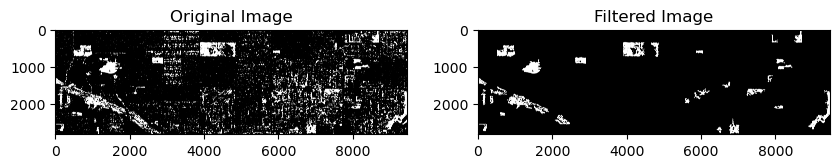

In [63]:
img_data = vacant_np

img = img_data.astype(np.uint8) * 255

kernel_size = (5, 5) 

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, kernel_size)
eroded_img = cv2.erode(img, kernel, iterations=1)
dilated_img = cv2.dilate(eroded_img, kernel, iterations=1)

min_area = 10000
nb_components, output, stats, _ = cv2.connectedComponentsWithStats(dilated_img, connectivity=8)
sizes = stats[1:, -1]
nb_components = nb_components - 1

filtered_img = np.zeros_like(dilated_img)
for i in range(0, nb_components):
    if sizes[i] >= min_area:
        filtered_img[output == i + 1] = 255

filtered_tensor = torch.from_numpy(filtered_img / 255).int()

plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(vacant_np, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(filtered_tensor, cmap='gray')
plt.title('Filtered Image')

plt.show()

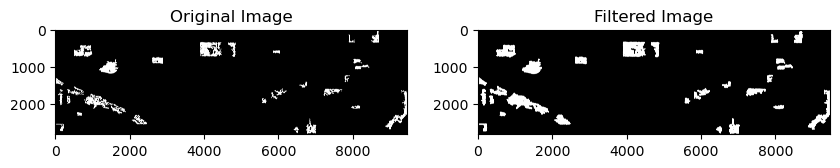

In [64]:
filtered_img_er = 1 - filtered_tensor.numpy()
filtered_255 = filtered_img_er.astype(np.uint8) * 255
kernel_size = (25, 25) 

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, kernel_size)
eroded_img2 = cv2.erode(filtered_255, kernel, iterations=1)
processed_vacant_1 = torch.from_numpy(eroded_img2 / 255).int()
processed_vacant=1-processed_vacant_1

plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(filtered_tensor, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(processed_vacant, cmap='gray')
plt.title('Filtered Image')

plt.show()

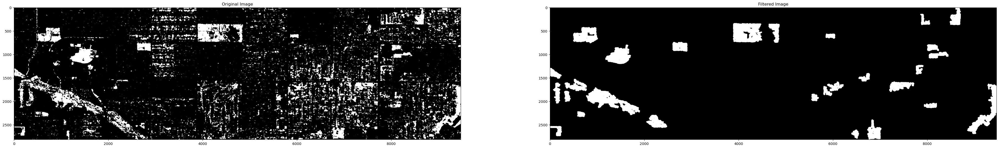

In [65]:
plt.figure(figsize=(50, 50))
plt.subplot(1, 2, 1)
plt.imshow(vacant_np, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(processed_vacant, cmap='gray')
plt.title('Filtered Image')

plt.show()

/var/folders/wj/s6z222bj37gb_98htrdc0t0w0000gn/T/ipykernel_1105/3020015076.py:5: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(vacant_np[x:x+500,y:y+500], cmap='gray')
/var/folders/wj/s6z222bj37gb_98htrdc0t0w0000gn/T/ipykernel_1105/3020015076.py:9: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(processed_vacant[x:x+500,y:y+500], cmap='gray')


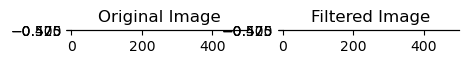

In [66]:
x=3500
y=3800
plt.figure(figsize=(5, 5))
plt.subplot(1, 2, 1)
plt.imshow(vacant_np[x:x+500,y:y+500], cmap='gray')
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(processed_vacant[x:x+500,y:y+500], cmap='gray')
plt.title('Filtered Image')

plt.show()

In [67]:
processed_vacant=processed_vacant.numpy()

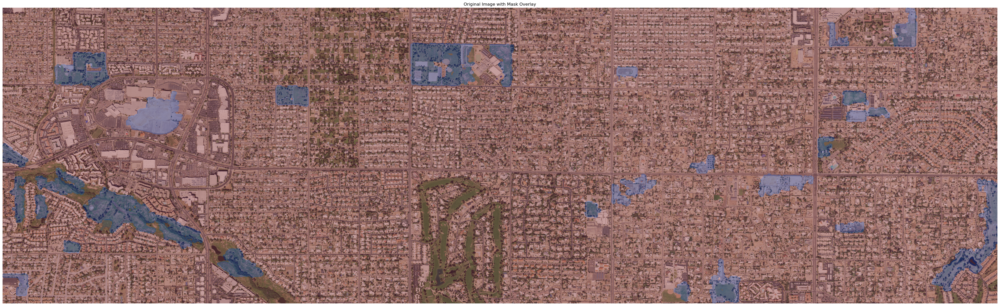

In [68]:
mask_colored1 = cv2.applyColorMap(cv2.convertScaleAbs(processed_vacant, alpha=255/processed_vacant.max()), cv2.COLORMAP_JET)

blended_image = blend_images(original_image, mask_colored1, opacity=opacity)

plt.figure(figsize=(50,50))
plt.imshow(blended_image)
plt.title('Original Image with Mask Overlay')
plt.axis('off')
plt.show()


In [69]:
image = cv2.imread('/Users/bhoumik/Documents/Projects/Satellite CV Project/Dataset/NAIP Dataset/Evaluation/paradise_temp.tif', cv2.IMREAD_UNCHANGED)
image = image.astype('float32')

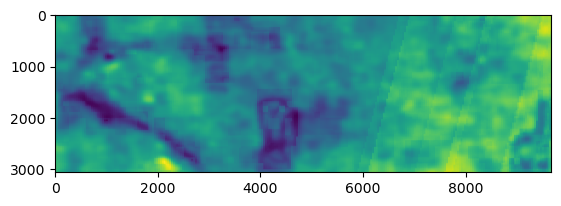

In [70]:
plt.imshow(image)

In [71]:
lst=image

In [72]:
lst_tf=tf.constant(lst)
image_tensor = lst_tf

image_tensor_float = tf.cast(image_tensor, tf.float32)

temperature_kelvin = (image_tensor_float * 0.00341802) + 149

temperature_celsius = temperature_kelvin - 273.15

In [73]:
temp=temperature_celsius.numpy()

In [74]:
temp=image-273.15

In [75]:
temp.shape

(3058, 9670)

In [76]:
temp=temp[:(l//256)*256,:(w//256)*256]

In [77]:
temp.shape

(2816, 9472)

In [78]:
temp.max()

36.042603

Text(0, 0.5, 'Y Coordinate')

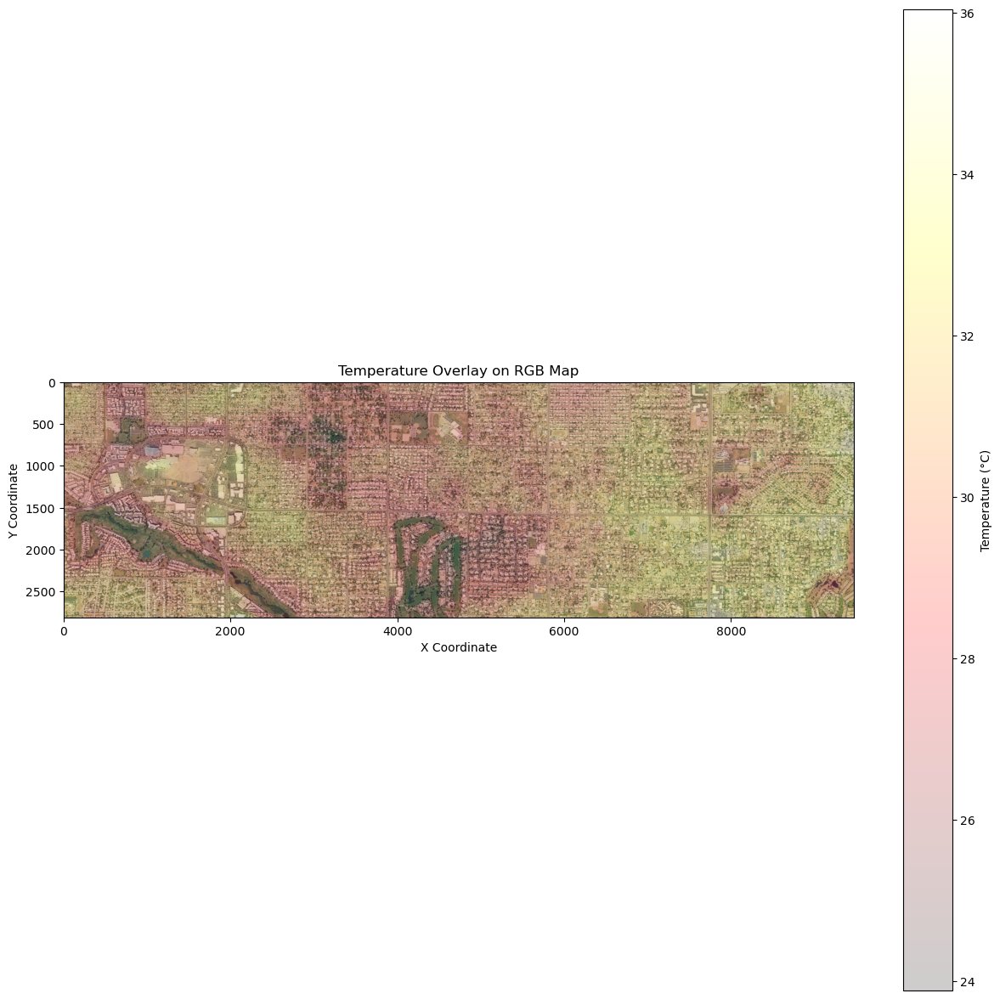

In [79]:
fig, ax = plt.subplots(figsize=(15, 15)) 

ax.imshow(original_image)

temp_display = ax.imshow(temp, cmap='hot', alpha=0.2)

cbar = plt.colorbar(temp_display)
cbar.set_label('Temperature (°C)')

ax.set_title('Temperature Overlay on RGB Map')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')

In [80]:
land_cover=torch.tensor(processed_vacant)

In [81]:
temp_cover=torch.tensor(temp)

In [82]:
land_cover_np = land_cover.numpy() 

labeled_array, num_vacant_pieces = label(land_cover_np)

print(f"Number of distinct vacant pieces of land: {num_vacant_pieces}")

Number of distinct vacant pieces of land: 28


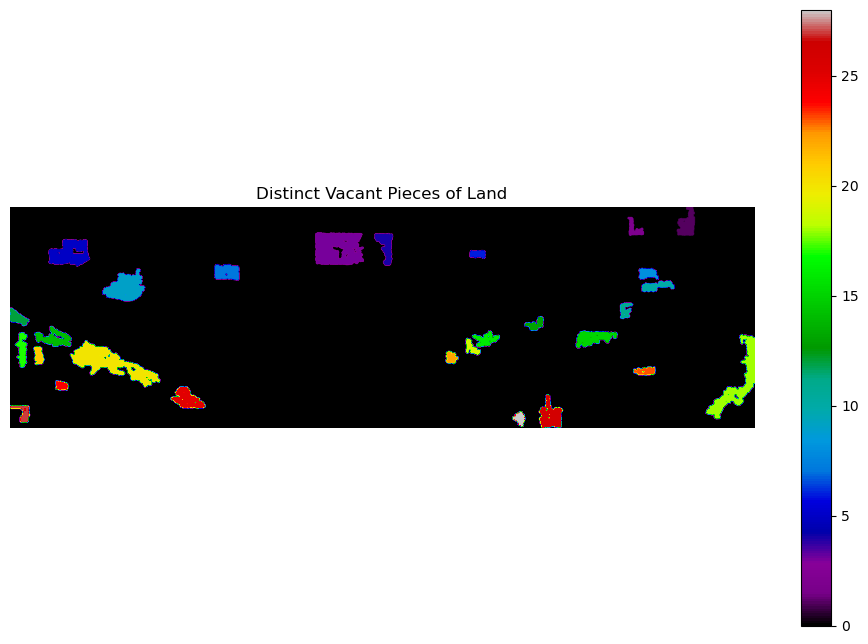

In [83]:
plt.figure(figsize=(12, 8))
plt.imshow(labeled_array, cmap='nipy_spectral')   
plt.colorbar()  
plt.title('Distinct Vacant Pieces of Land')
plt.axis('off')  
plt.show()

In [84]:
def find_large_vacant_lands_labels_and_sizes(labeled_array, min_size=100000):
    """
    Find the labels and sizes of all vacant lands greater than a specified size.
    
    Parameters:
    - labeled_array: A 2D numpy array where each distinct vacant land area is labeled with a unique integer.
    - min_size: The minimum size (in pixels) to consider a vacant land area as large.
    
    Returns:
    - A dictionary where keys are labels of vacant lands larger than the specified size, 
      and values are the sizes of these lands.
    """
    
    area_sizes = np.bincount(labeled_array.flatten())
    
    large_labels = np.where(area_sizes > min_size)[0]
    
    large_vacant_lands_labels_and_sizes = {label: area_sizes[label] for label in large_labels if label != 0} 
    
    return large_vacant_lands_labels_and_sizes

large_labels_and_sizes = find_large_vacant_lands_labels_and_sizes(labeled_array, 100000)
print("Labels of vacant lands larger than 1000 pixels and their sizes:")
for label, size in large_labels_and_sizes.items():
    print(f"Label: {label}, Size: {size} pixels")
len(large_labels_and_sizes)

Labels of vacant lands larger than 1000 pixels and their sizes:
Label: 3, Size: 221200 pixels
Label: 5, Size: 127642 pixels
Label: 9, Size: 134277 pixels
Label: 18, Size: 182662 pixels
Label: 20, Size: 247519 pixels


5

In [85]:
def plot_vacant_land_area(labeled_array, label_number):
    vacant_land_mask = (labeled_array == label_number)
    
    area_size = np.sum(vacant_land_mask)
    
    plt.figure(figsize=(10, 6))
    plt.imshow(vacant_land_mask, cmap='gray')
    plt.title(f'Vacant Land Area with Label {label_number}, Size: {area_size} pixels')
    plt.axis('on') 
    plt.show()
    return vacant_land_mask


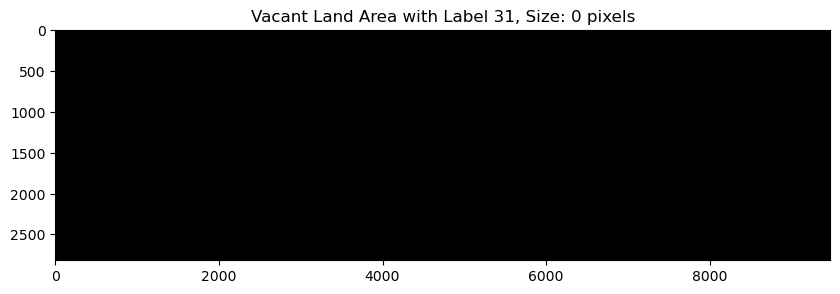

In [86]:
vacant_land_mask=plot_vacant_land_area(labeled_array,31)

In [87]:
def remove_large_vacant_lands(labeled_array, max_size=100000):
    
    area_sizes = np.bincount(labeled_array.flatten())
    
    large_labels = np.where(area_sizes > max_size)[0]
    
    for label in large_labels:
        if label != 0:  
            labeled_array[labeled_array == label] = 0
            
    return labeled_array

modified_labeled_array = remove_large_vacant_lands(labeled_array, 100000)


In [88]:
from scipy.ndimage import label

re_labeled_array, num_features = label(modified_labeled_array > 0)
print(f"Total number of distinct vacant lands after removal and re-labeling: {num_features}")

Total number of distinct vacant lands after removal and re-labeling: 23


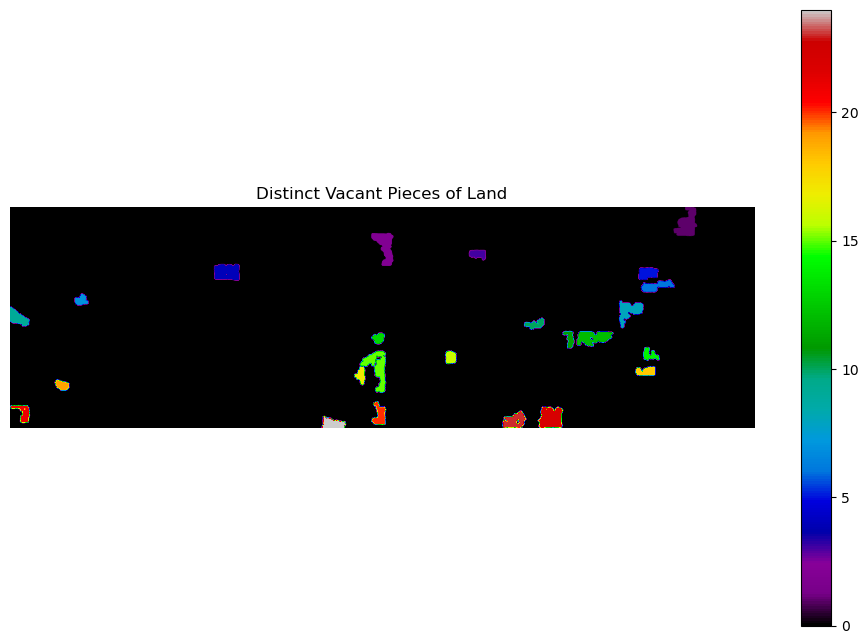

In [99]:
plt.figure(figsize=(12, 8))
plt.imshow(re_labeled_array, cmap='nipy_spectral') 
plt.colorbar()  
plt.title('Distinct Vacant Pieces of Land')
plt.axis('off')  
plt.show()

In [100]:
# import numpy as np
# from scipy.ndimage import distance_transform_edt

# def allocate_forest_area(land, heat_map, total_area):
#     cumulative_cooling_effect = np.zeros_like(heat_map)
#     selected_vacant_lands = []

#     while total_area > 0:
#         vacant_ids = np.unique(land[land > 0])
#         if len(vacant_ids) == 0:
#             break  # No more vacant lands to consider
        
#         filtered_vacant_ids = [vid for vid in vacant_ids if np.sum(land == vid) <= total_area]
#         print(filtered_vacant_ids)
#         best_vacant_id = None
#         highest_mean_temp = -np.inf
        
#         for vacant_id in filtered_vacant_ids:
#             mean_temp = calculate_mean_temperature(land, heat_map, vacant_id)
#             if mean_temp > highest_mean_temp:
#                 highest_mean_temp = mean_temp
#                 best_vacant_id = vacant_id
#         print(best_vacant_id)
#         if best_vacant_id is None:
#             break  # No suitable vacant land found within the remaining area

#         vacant_land_size = np.sum(land == best_vacant_id)
#         print(vacant_land_size)
#         heat_map, cumulative_cooling_effect = update_heat_map(land, heat_map, best_vacant_id, cumulative_cooling_effect)
#         print("updated")
#         land[land == best_vacant_id] = 0
#         total_area -= vacant_land_size
#         selected_vacant_lands.append(best_vacant_id)
#         print(total_area)
            
#     return land, heat_map, selected_vacant_lands, total_area

# def calculate_mean_temperature(land, heat_map, vacant_id):
#     """
#     Calculate the mean temperature for the given vacant land and its 900m buffer zone.
#     """
#     mask = land == vacant_id
#     distances = distance_transform_edt(~mask) * 1  # Assuming 1m per pixel
#     buffer_mask = distances <= 900
#     return np.mean(heat_map[buffer_mask])

# import numpy as np
# from scipy.ndimage import distance_transform_edt

# def update_heat_map(land, heat_map, selected_vacant_id, cumulative_cooling_effect):
#     """
#     Simulate afforestation by updating the heat map based on the cooling effect of planting trees,
#     ensuring the cumulative cooling effect for each pixel does not exceed 6 degrees Celsius.
#     """
#     k, x0, alpha = 0.4, 25, 1  # Define constants
#     S = np.sum(land == selected_vacant_id)  # Area of the selected vacant land
    
#     distances_pixels = distance_transform_edt(land != selected_vacant_id) * 1  # Distance in meters
#     distances_meters = np.clip(distances_pixels, None, 900)  # Limiting to 900 meters
    
#     cooling_effect = (6 / (1 + np.exp(-k * (heat_map - x0 + alpha * np.log(S))))) * np.minimum(1, ((5.76 - 0.847 * np.log(np.maximum(distances_meters, 0.001))) / 5.76))
#     cooling_effect = np.where((land != selected_vacant_id) & (distances_meters <= 900), cooling_effect, 0)
    
#     forest_cooling_effect = 6 / (1 + np.exp(-k * (heat_map[land == selected_vacant_id] - x0 + alpha * np.log(S))))
    
#     new_cooling_effect = np.zeros_like(heat_map)
#     new_cooling_effect[land == selected_vacant_id] = forest_cooling_effect
#     new_cooling_effect += cooling_effect  # Include buffer zone cooling effect
    
#     effective_cooling = np.minimum(6 - cumulative_cooling_effect, new_cooling_effect)
#     heat_map -= effective_cooling
#     cumulative_cooling_effect += effective_cooling
    
#     return heat_map, cumulative_cooling_effect



In [101]:
# new_land,new_temp,selected_lands,left_area=allocate_forest_area(re_labeled_array.copy(), temp.copy(), 50000)

In [104]:
pop = cv2.imread('/Users/bhoumik/Documents/Projects/Satellite CV Project/Dataset/NAIP Dataset/Evaluation/paradise_pop.tif', cv2.IMREAD_UNCHANGED)
pop = pop.astype('float32')
population_density=pop

In [105]:
import pandas as pd
import numpy as np

def fill_nan_with_pandas(data):
    df = pd.DataFrame(data)
    
    df.interpolate(method='linear', axis=0, inplace=True, limit_direction='both')  # Vertical
    df.interpolate(method='linear', axis=1, inplace=True, limit_direction='both')  # Horizontal
    
    df.fillna(df.mean(), inplace=True)
    
    return df.values

population_density_cleaned = fill_nan_with_pandas(population_density)


In [106]:
population_density=population_density[:(l//256)*256,:(w//256)*256]

In [107]:
import numpy as np
from scipy.ndimage import distance_transform_edt

def calculate_population_density(land, population_density, buffer=900):
    """
    Calculate the average population density within a buffer zone around each vacant land.
    
    Parameters:
    - land: 2D numpy array of land cover, where vacant lands are marked with unique IDs.
    - population_density: 2D numpy array of population density data.
    - buffer: Buffer distance around each vacant land to calculate population density.
    
    Returns:
    - Dictionary of vacant land IDs to their corresponding average population density within the buffer.
    """
    vacant_ids = np.unique(land[land > 0])
    density_dict = {}
    
    for vacant_id in vacant_ids:
        mask = land == vacant_id
        distances = distance_transform_edt(~mask) * 1  # assuming 1m per pixel
        buffer_mask = distances <= buffer
        combined_mask = mask | buffer_mask
        mean_density = np.mean(population_density[combined_mask])
        density_dict[vacant_id] = mean_density
        print(1)
    
    return density_dict


In [108]:
density_dict=calculate_population_density(re_labeled_array,population_density)

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


In [109]:
density_dict

{1: 6.3365793,
 2: 8.703642,
 3: 9.815586,
 4: 10.0178385,
 5: 6.394468,
 6: 6.6768236,
 7: 17.248287,
 8: 6.4214354,
 9: 17.70169,
 10: 6.229848,
 11: 5.6913786,
 12: 5.766207,
 13: 7.4133077,
 14: 5.9488926,
 15: 6.9111667,
 16: 6.1361313,
 17: 6.801711,
 18: 5.9908605,
 19: 13.690202,
 20: 5.2589254,
 21: 11.323434,
 22: 5.6119175,
 23: 5.888113,
 24: 5.7871046}

In [110]:
#population integrated
import numpy as np
from scipy.ndimage import distance_transform_edt

def allocate_forest_area(land, heat_map, total_area, population_density_dict):
    cumulative_cooling_effect = np.zeros_like(heat_map)
    selected_vacant_lands = []

    while total_area > 0:
        vacant_ids = np.unique(land[land > 0])
        if len(vacant_ids) == 0:
            break  
        filtered_vacant_ids = [vid for vid in vacant_ids if np.sum(land == vid) <= total_area]
        print(filtered_vacant_ids)
        best_vacant_id = None
        highest_score = -np.inf

        for vacant_id in filtered_vacant_ids:
            mean_temp = calculate_mean_temperature(land, heat_map, vacant_id)
            density_score = population_density_dict.get(vacant_id, 0)
            score = mean_temp * density_score 
            
            if score > highest_score:
                highest_score = score
                best_vacant_id = vacant_id

        print(best_vacant_id)
        if best_vacant_id is None:
            break  
        vacant_land_size = np.sum(land == best_vacant_id)
        print(vacant_land_size)
        heat_map, cumulative_cooling_effect = update_heat_map(land, heat_map, best_vacant_id, cumulative_cooling_effect)
        print("updated")
        land[land == best_vacant_id] = 0
        total_area -= vacant_land_size
        selected_vacant_lands.append(best_vacant_id)
        print(total_area)

    return land, heat_map, selected_vacant_lands, total_area

def calculate_mean_temperature(land, heat_map, vacant_id):
    """
    Calculate the mean temperature for the given vacant land and its 900m buffer zone.
    """
    mask = land == vacant_id
    distances = distance_transform_edt(~mask) * 1  # Assuming 1m per pixel
    buffer_mask = distances <= 900
    return np.mean(heat_map[buffer_mask])

import numpy as np
from scipy.ndimage import distance_transform_edt

def update_heat_map(land, heat_map, selected_vacant_id, cumulative_cooling_effect):
    """
    Simulate afforestation by updating the heat map based on the cooling effect of planting trees,
    ensuring the cumulative cooling effect for each pixel does not exceed 6 degrees Celsius.
    """
    k, x0, alpha = 0.4, 25, 1  # Define constants
    S = np.sum(land == selected_vacant_id)  # Area of the selected vacant land
    
    distances_pixels = distance_transform_edt(land != selected_vacant_id) * 1  # Distance in meters
    distances_meters = np.clip(distances_pixels, None, 900)  # Limiting to 900 meters
    
    cooling_effect = (6 / (1 + np.exp(-k * (heat_map - x0 + alpha * np.log(S))))) * np.minimum(1, ((5.76 - 0.847 * np.log(np.maximum(distances_meters, 0.001))) / 5.76))
    cooling_effect = np.where((land != selected_vacant_id) & (distances_meters <= 900), cooling_effect, 0)
    
    forest_cooling_effect = 6 / (1 + np.exp(-k * (heat_map[land == selected_vacant_id] - x0 + alpha * np.log(S))))
    
    new_cooling_effect = np.zeros_like(heat_map)
    new_cooling_effect[land == selected_vacant_id] = forest_cooling_effect
    new_cooling_effect += cooling_effect  # Include buffer zone cooling effect
    
    effective_cooling = np.minimum(6 - cumulative_cooling_effect, new_cooling_effect)
    heat_map -= effective_cooling
    cumulative_cooling_effect += effective_cooling
    
    return heat_map, cumulative_cooling_effect



In [111]:
new_land,new_temp,selected_lands,left_area=allocate_forest_area(re_labeled_array.copy(), temp.copy(), 100000,density_dict)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]
9
34650
updated
65350
[2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24]
7
17573
updated
47777
[3, 5, 6, 10, 11, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24]
19
17867
updated
29910
[3, 10, 11, 13, 14, 16, 17, 18, 21]
21
27864
updated
2046
[]
None


In [112]:
selected_lands

[9, 7, 19, 21]

Text(0, 0.5, 'Y Coordinate')

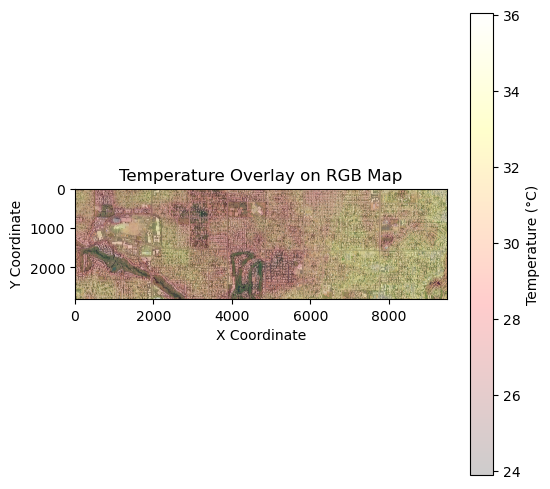

In [114]:
fig, ax = plt.subplots(figsize=(6, 6)) 

ax.imshow(original_image)

temp_display = ax.imshow(temp, cmap='hot', alpha=0.2)

cbar = plt.colorbar(temp_display)
cbar.set_label('Temperature (°C)')

ax.set_title('Temperature Overlay on RGB Map')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')

Text(0, 0.5, 'Y Coordinate')

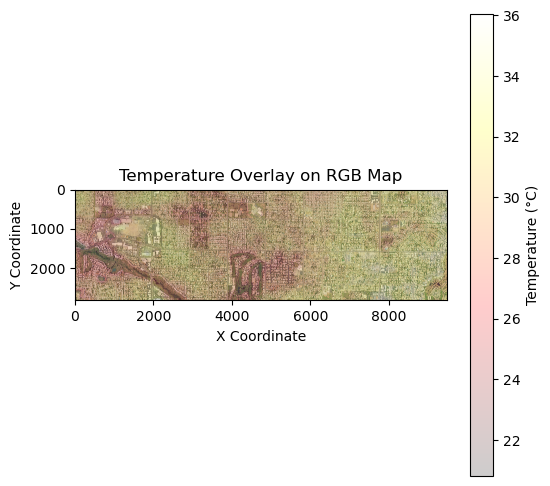

In [116]:
fig, ax = plt.subplots(figsize=(6, 6)) 

ax.imshow(original_image)

temp_display = ax.imshow(new_temp, cmap='hot', alpha=0.2)

cbar = plt.colorbar(temp_display)
cbar.set_label('Temperature (°C)')

ax.set_title('Temperature Overlay on RGB Map')
ax.set_xlabel('X Coordinate')
ax.set_ylabel('Y Coordinate')